##Dataset Description
The dataset consists of synthetic financial transactions generated by IBM to simulate a virtual world with individuals, companies, and banks. The data includes both legitimate and laundering transactions, with laundering transactions labeled to help train models for anti-money laundering (AML). The generator models the full money laundering cycle: Placement, Layering, and Integration.

####There are two groups of datasets:

-Group HI: Higher illicit transaction ratio, simulating more laundering activity.
-Group LI: Lower illicit transaction ratio, simulating less laundering activity.

Each group has three datasets (small, medium, large) with varying numbers of transactions and bank accounts, allowing for flexibility based on modeling and computational resources.

#####I will be using HI-Medium and LI-Medium :

to balance between computational resources and project goals

######-Dataset Size BEFORE data engineering = 17.95 GB

######-Dataset Size AFTER data engineering = 5.08 GB

#####Each dataset includes:

-CSV files containing transaction details such as timestamps, sender and receiver account information, transaction amount and currency, and payment format.

-TXT files listing laundering patterns identified by specific transaction sequences, which indicate certain laundering structures (e.g., fan-out, cycle, gather-scatter, and stack).

#####Attributes:


######-Timestamp
Year/Month/Day Hour/Minute

######-From_Bank
Numeric code for bank where transaction originates

######-From_Account
Hexadecimal code for account where transaction originates

######-To_Bank
Numeric code for bank where transaction ends

######-To_Account
Hexadecimal code for account where transaction ends

######-Amount_Received
Monetary amount received in From account (in currency units of the next column)

######-Receiving_Currency
Currency such as dollars, euros, etc of From account

######-Amount_Paid
Monetary amount paid (in currency units of the next column)

######-Payment_Currency
Currency such as dollars, euros, etc of From account

######-Payment_Format
How transaction was conducted, e.g. cheque, ACH, wire, credit cards, etc.

#####Problem Type: Classification 
The primary goal is to detect money laundering transactions, making this a classification problem. Each transaction is labeled as either legitimate or laundering, and the model needs to classify transactions based on patterns or behaviors indicative of laundering.

#####Models used: 

  **Random Forest Classifier** : F1 Score: 0.963



##Setup and Data Loading

In [ ]:
import os
import json
import zipfile
from pyspark.sql import SparkSession
import random
from pyspark.sql.types import StructType, StructField, StringType, FloatType, IntegerType, DoubleType
from pyspark.sql import functions as F
from pyspark.sql.functions import col, sum, when, count, avg, to_timestamp, hour, dayofweek
from pyspark.ml.feature import StringIndexer, VectorAssembler, StandardScaler
from pyspark.sql import Window
import seaborn as sns
import matplotlib.pyplot as plt
from pyspark.ml.stat import Correlation
import numpy as np
from pyspark.ml import Pipeline
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator



%pip install kaggle

dbutils.fs.mkdirs("/FileStore")
dbutils.fs.put("/FileStore/kaggle.json", """
{
  "username": "ebaahossam",
  "key": "edda67c803b4953e79563d4014Paad340"
}
""")

In [ ]:
os.environ['KAGGLE_CONFIG_DIR'] = '/dbfs/FileStore'
dbutils.fs.mkdirs("/FileStore/kaggle_data")
!kaggle datasets download -d ealtman2019/ibm-transactions-for-anti-money-laundering-aml -p /dbfs/FileStore/kaggle_data --force

In [ ]:


def extract_csv_file(zip_path, file_name, extract_path, final_dbfs_path):
    # Extract the specific file from the zip
    with zipfile.ZipFile(zip_path, 'r') as z:
        if file_name in z.namelist():
            z.extract(file_name, "/databricks/driver/")  # Extract to local driver
            print(f"File extracted to /databricks/driver/{file_name}")

            # Move the file to DBFS for Spark to read
            dbutils.fs.cp(f"file:/databricks/driver/{file_name}", final_dbfs_path)
            print(f"File moved to {final_dbfs_path}")

            # Define schema for the transactions
            schema = StructType([
                StructField("Timestamp", StringType(), True),
                StructField("From_Bank", StringType(), True),
                StructField("From_Account", StringType(), True),
                StructField("To_Bank", StringType(), True),
                StructField("To_Account", StringType(), True),
                StructField("Amount_Received", FloatType(), True),
                StructField("Receiving_Currency", StringType(), True),
                StructField("Amount_Paid", FloatType(), True),
                StructField("Payment_Currency", StringType(), True),
                StructField("Payment_Format", StringType(), True)
            ])

            # Read and display the file
            df = spark.read.csv(final_dbfs_path,schema=schema, header=True)
        else:
            print(f"{file_name} not found in the zip file.")
    
    return df


In [ ]:
hi_medium_df = extract_csv_file("/dbfs/FileStore/kaggle_data/ibm-transactions-for-anti-money-laundering-aml.zip", "HI-Medium_Trans.csv", "/dbfs/FileStore/kaggle_data", "/FileStore/HI-Medium_Trans.csv")

In [ ]:
li_medium_df = extract_csv_file("/dbfs/FileStore/kaggle_data/ibm-transactions-for-anti-money-laundering-aml.zip", "LI-Medium_Trans.csv", "/dbfs/FileStore/kaggle_data", "/FileStore/LI-Medium_Trans.csv")

##Combine HI-Medium and LI-Medium
for real world scenario 

In [ ]:
# Combine both datasets
combined_df = hi_medium_df.union(li_medium_df)

In [ ]:
combined_df.cache().display()

Timestamp,From_Bank,From_Account,To_Bank,To_Account,Amount_Received,Receiving_Currency,Amount_Paid,Payment_Currency,Payment_Format
2022/09/01 00:17,020,800104D70,020,800104D70,6794.63,US Dollar,6794.63,US Dollar,Reinvestment
2022/09/01 00:02,03196,800107150,03196,800107150,7739.29,US Dollar,7739.29,US Dollar,Reinvestment
2022/09/01 00:17,01208,80010E430,01208,80010E430,1880.23,US Dollar,1880.23,US Dollar,Reinvestment
2022/09/01 00:03,01208,80010E650,020,80010E6F0,7.396688E7,US Dollar,7.396688E7,US Dollar,Cheque
2022/09/01 00:02,01208,80010E650,020,80010EA30,4.5868456E7,US Dollar,4.5868456E7,US Dollar,Cheque
2022/09/01 00:27,03203,80010EA80,03203,80010EA80,13284.41,US Dollar,13284.41,US Dollar,Reinvestment
2022/09/01 00:25,020,800104D20,020,800104D20,9.72,US Dollar,9.72,US Dollar,Reinvestment
2022/09/01 00:09,01208,80010E430,01208,80010E430,7.66,US Dollar,7.66,US Dollar,Reinvestment
2022/09/01 00:09,011,80010E600,011,80010E600,16.33,US Dollar,16.33,US Dollar,Reinvestment
2022/09/01 00:06,01208,80010E650,01208,80010E650,4.86,US Dollar,4.86,US Dollar,Reinvestment


In [ ]:
def extract_text(zip_path, file_name, extract_path, final_dbfs_path):
    # Extract the specific file from the zip
    with zipfile.ZipFile(zip_path, 'r') as z:
        if file_name in z.namelist():
            z.extract(file_name, "/databricks/driver/")  # Extract to local driver
            print(f"File extracted to /databricks/driver/{file_name}")

            # Move the file to DBFS for Spark to read
            dbutils.fs.cp(f"file:/databricks/driver/{file_name}", final_dbfs_path)
            print(f"File moved to {final_dbfs_path}")

            # Read and display the file
            df = spark.read.text(final_dbfs_path)
        else:
            print(f"{file_name} not found in the zip file.")
    
    return df


In [ ]:
# Load both pattern files
hi_patterns_df = extract_text("/dbfs/FileStore/kaggle_data/ibm-transactions-for-anti-money-laundering-aml.zip", "HI-Medium_Patterns.txt", "/dbfs/FileStore/kaggle_data", "/FileStore/HI-Medium_Patterns.txt")
li_patterns_df = extract_text("/dbfs/FileStore/kaggle_data/ibm-transactions-for-anti-money-laundering-aml.zip", "LI-Medium_Patterns.txt", "/dbfs/FileStore/kaggle_data", "/FileStore/LI-Medium_Patterns.txt")


In [ ]:
# Union both pattern DataFrames
patterns_df = hi_patterns_df.union(li_patterns_df)

In [ ]:
patterns_df.cache().display()

value
BEGIN LAUNDERING ATTEMPT - STACK
"2022/09/01 05:14,00952,8139F54E0,0111632,8062C56E0,5331.44,US Dollar,5331.44,US Dollar,ACH,1"
"2022/09/03 13:09,0111632,8062C56E0,008456,81363F620,5602.59,US Dollar,5602.59,US Dollar,ACH,1"
"2022/09/01 07:40,0118693,823D5EB90,013729,801CF2E60,1400.54,US Dollar,1400.54,US Dollar,ACH,1"
"2022/09/01 14:19,013729,801CF2E60,0123621,81A7090F0,1467.94,US Dollar,1467.94,US Dollar,ACH,1"
"2022/09/02 12:40,0024750,81363F410,0213834,808757B00,16898.29,US Dollar,16898.29,US Dollar,ACH,1"
"2022/09/03 06:34,0213834,808757B00,000,800073EF0,17607.19,US Dollar,17607.19,US Dollar,ACH,1"
END LAUNDERING ATTEMPT - STACK
""
BEGIN LAUNDERING ATTEMPT - CYCLE: Max 12 hops


##Identify Laundering Patterns:

Each laundering attempt begins with BEGIN LAUNDERING ATTEMPT - [PATTERN] and ends with END LAUNDERING ATTEMPT.

Used regex to extract pattern types (e.g., Fan-Out, Cycle, Gather-Scatter, Stack) and transaction details.

In [ ]:


# Step 1: Extract Pattern_Type where there is "BEGIN LAUNDERING ATTEMPT"
patterns_df = patterns_df.withColumn(
    "Pattern_Type",
    F.when(F.col("value").rlike("BEGIN LAUNDERING ATTEMPT - (.+)"), 
           F.regexp_extract(F.col("value"), "BEGIN LAUNDERING ATTEMPT - (.+)", 1))
     .otherwise(None)
)

# Step 2: Forward fill the Pattern_Type to propagate it down until "END LAUNDERING ATTEMPT"
window_spec = Window.orderBy(F.monotonically_increasing_id()).rowsBetween(Window.unboundedPreceding, 0)
patterns_df = patterns_df.withColumn(
    "Pattern_Type",
    F.last("Pattern_Type", True).over(window_spec)
)

# Step 3: Filter out rows with "END LAUNDERING ATTEMPT" as they only mark the end of an attempt
patterns_df = patterns_df.filter(~F.col("value").contains("END LAUNDERING ATTEMPT"))



In [ ]:
patterns_df.display()

value,Pattern_Type
BEGIN LAUNDERING ATTEMPT - STACK,STACK
"2022/09/01 05:14,00952,8139F54E0,0111632,8062C56E0,5331.44,US Dollar,5331.44,US Dollar,ACH,1",STACK
"2022/09/03 13:09,0111632,8062C56E0,008456,81363F620,5602.59,US Dollar,5602.59,US Dollar,ACH,1",STACK
"2022/09/01 07:40,0118693,823D5EB90,013729,801CF2E60,1400.54,US Dollar,1400.54,US Dollar,ACH,1",STACK
"2022/09/01 14:19,013729,801CF2E60,0123621,81A7090F0,1467.94,US Dollar,1467.94,US Dollar,ACH,1",STACK
"2022/09/02 12:40,0024750,81363F410,0213834,808757B00,16898.29,US Dollar,16898.29,US Dollar,ACH,1",STACK
"2022/09/03 06:34,0213834,808757B00,000,800073EF0,17607.19,US Dollar,17607.19,US Dollar,ACH,1",STACK
,STACK
BEGIN LAUNDERING ATTEMPT - CYCLE: Max 12 hops,CYCLE: Max 12 hops
"2022/09/01 00:19,0134266,814167590,0036925,810E343A0,132713.46,Yuan,132713.46,Yuan,ACH,1",CYCLE: Max 12 hops


In [ ]:

# Remove any text after the colon in Pattern_Type if it exists
patterns_df = patterns_df.withColumn(
    "Pattern_Type",
    F.regexp_replace(F.col("Pattern_Type"), ":.*", "")
)



In [ ]:
patterns_df.display()

value,Pattern_Type
BEGIN LAUNDERING ATTEMPT - STACK,STACK
"2022/09/01 05:14,00952,8139F54E0,0111632,8062C56E0,5331.44,US Dollar,5331.44,US Dollar,ACH,1",STACK
"2022/09/03 13:09,0111632,8062C56E0,008456,81363F620,5602.59,US Dollar,5602.59,US Dollar,ACH,1",STACK
"2022/09/01 07:40,0118693,823D5EB90,013729,801CF2E60,1400.54,US Dollar,1400.54,US Dollar,ACH,1",STACK
"2022/09/01 14:19,013729,801CF2E60,0123621,81A7090F0,1467.94,US Dollar,1467.94,US Dollar,ACH,1",STACK
"2022/09/02 12:40,0024750,81363F410,0213834,808757B00,16898.29,US Dollar,16898.29,US Dollar,ACH,1",STACK
"2022/09/03 06:34,0213834,808757B00,000,800073EF0,17607.19,US Dollar,17607.19,US Dollar,ACH,1",STACK
,STACK
BEGIN LAUNDERING ATTEMPT - CYCLE: Max 12 hops,CYCLE
"2022/09/01 00:19,0134266,814167590,0036925,810E343A0,132713.46,Yuan,132713.46,Yuan,ACH,1",CYCLE


In [ ]:
# Filter to get only transaction lines and ignore start/end laundering attempt lines
laundering_transactions = patterns_df.filter(patterns_df.value.rlike(r'\d{4}/\d{2}/\d{2}'))
patterns_df.unpersist()
laundering_transactions.cache().display()

value,Pattern_Type
"2022/09/01 05:14,00952,8139F54E0,0111632,8062C56E0,5331.44,US Dollar,5331.44,US Dollar,ACH,1",STACK
"2022/09/03 13:09,0111632,8062C56E0,008456,81363F620,5602.59,US Dollar,5602.59,US Dollar,ACH,1",STACK
"2022/09/01 07:40,0118693,823D5EB90,013729,801CF2E60,1400.54,US Dollar,1400.54,US Dollar,ACH,1",STACK
"2022/09/01 14:19,013729,801CF2E60,0123621,81A7090F0,1467.94,US Dollar,1467.94,US Dollar,ACH,1",STACK
"2022/09/02 12:40,0024750,81363F410,0213834,808757B00,16898.29,US Dollar,16898.29,US Dollar,ACH,1",STACK
"2022/09/03 06:34,0213834,808757B00,000,800073EF0,17607.19,US Dollar,17607.19,US Dollar,ACH,1",STACK
"2022/09/01 00:19,0134266,814167590,0036925,810E343A0,132713.46,Yuan,132713.46,Yuan,ACH,1",CYCLE
"2022/09/01 19:35,0036925,810E343A0,0119211,814AB4F60,18264.20,US Dollar,18264.20,US Dollar,ACH,1",CYCLE
"2022/09/02 02:58,0119211,814AB4F60,0132965,81B88A230,14567.69,Euro,14567.69,Euro,ACH,1",CYCLE
"2022/09/02 18:02,0132965,81B88A230,0137089,810C71940,114329.26,Yuan,114329.26,Yuan,ACH,1",CYCLE


In [ ]:

# Split the 'value' column into multiple columns
laundering_transactions = laundering_transactions.withColumn("Timestamp", F.split(F.col("value"), ",").getItem(0)) \
    .withColumn("From_Bank", F.split(F.col("value"), ",").getItem(1)) \
    .withColumn("From_Account", F.split(F.col("value"), ",").getItem(2)) \
    .withColumn("To_Bank", F.split(F.col("value"), ",").getItem(3)) \
    .withColumn("To_Account", F.split(F.col("value"), ",").getItem(4)) \
    .withColumn("Amount_Received", F.split(F.col("value"), ",").getItem(5)) \
    .withColumn("Receiving_currency", F.split(F.col("value"), ",").getItem(6)) \
    .withColumn("Amount_paid", F.split(F.col("value"), ",").getItem(7)) \
    .withColumn("Payment_currency", F.split(F.col("value"), ",").getItem(8)) \
    .withColumn("Payment_Format", F.split(F.col("value"), ",").getItem(9)) \
    .withColumn("isLaundering", F.split(F.col("value"), ",").getItem(10))

In [ ]:
laundering_transactions = laundering_transactions.select("Timestamp", "From_Bank", "Pattern_Type", "isLaundering")
laundering_transactions.display()

Timestamp,From_Bank,Pattern_Type,isLaundering
2022/09/01 05:14,00952,STACK,1
2022/09/03 13:09,0111632,STACK,1
2022/09/01 07:40,0118693,STACK,1
2022/09/01 14:19,013729,STACK,1
2022/09/02 12:40,0024750,STACK,1
2022/09/03 06:34,0213834,STACK,1
2022/09/01 00:19,0134266,CYCLE,1
2022/09/01 19:35,0036925,CYCLE,1
2022/09/02 02:58,0119211,CYCLE,1
2022/09/02 18:02,0132965,CYCLE,1


In [ ]:

# Count empty strings in each column
empty_string_counts = laundering_transactions.select([sum(when(col(c) == "", 1).otherwise(0)).alias(c) for c in laundering_transactions.columns])

# Show the result
empty_string_counts.show()

In [ ]:
laundering_transactions.createOrReplaceTempView("combined")

In [ ]:
%sql 

SELECT Pattern_Type, COUNT(Pattern_Type) AS count FROM combined GROUP BY Pattern_Type

Pattern_Type,count
STACK,4601
CYCLE,2518
FAN-IN,2644
GATHER-SCATTER,4830
BIPARTITE,2623
FAN-OUT,2617
SCATTER-GATHER,4874
RANDOM,1945


In [ ]:
laundering_transactions.cache().groupBy("isLaundering").count().show()

##Create Labels for Laundering Transactions:

Joined the laundering pattern DataFrame (laundering_transactions) with the combined transaction DataFrame (combined_df) on transaction identifiers.

In [ ]:

# Join the DataFrames on Timestamp, From_Bank, and To_Bank
joined_df = combined_df.join(
    laundering_transactions,
    on=["Timestamp", "From_Bank"],
    how="left"
)

#freeing from cache
combined_df.unpersist()
laundering_transactions.unpersist()




DataFrame[Timestamp: string, From_Bank: string, Pattern_Type: string, isLaundering: string]

In [ ]:
# Fill null values in the `isLaundering` column with 0
joined_df = joined_df.withColumn(
    "isLaundering",
    F.when(F.col("isLaundering").isNull(), F.lit(0)).otherwise(F.col("isLaundering"))
)

In [ ]:
joined_df.cache().display()

In [ ]:
# Convert 'isLaundering' from string to integer
joined_df = joined_df.withColumn("isLaundering", col("isLaundering").cast("integer"))


# Verify the schema change
joined_df.printSchema()

root
 |-- Timestamp: string (nullable = true)
 |-- From_Bank: string (nullable = true)
 |-- From_Account: string (nullable = true)
 |-- To_Bank: string (nullable = true)
 |-- To_Account: string (nullable = true)
 |-- Amount_Received: float (nullable = true)
 |-- Receiving_Currency: string (nullable = true)
 |-- Amount_Paid: float (nullable = true)
 |-- Payment_Currency: string (nullable = true)
 |-- Payment_Format: string (nullable = true)
 |-- Pattern_Type: string (nullable = true)
 |-- isLaundering: integer (nullable = true)



In [ ]:
size_in_memory_gb = joined_df.rdd.map(lambda row: len(str(row))).sum() / (1024 * 1024 * 1024)
print(f"Approximate size in memory: ({size_in_memory_gb:.2f} GB)")

Approximate size in memory: (17.95 GB)


##check data balance

In [ ]:
joined_df.groupBy("isLaundering").count().show()

+------------+--------+
|isLaundering|   count|
+------------+--------+
|           1|   84928|
|           0|63065007|
+------------+--------+



##Balance the data 

######DROP 50% of majority

######Use SMOTE to generate synthetic data of minority after data engineering


In [ ]:


# Register joined_df as a temporary view to use SQL
joined_df.createOrReplaceTempView("joined_table")

# Step 1: Identify rows to drop
# Here we assign a random value to each row that meets the condition, then select 50% of those rows
query = """
SELECT * 
FROM joined_table 
WHERE NOT ((Pattern_Type IS NULL) AND (isLaundering = 0) AND (rand() < 0.5))
"""

# Execute the SQL query
balanced_df = spark.sql(query)

In [ ]:
joined_df.unpersist()

In [ ]:
balanced_df.cache().groupBy("isLaundering").count().show()

+------------+--------+
|isLaundering|   count|
+------------+--------+
|           1|   84928|
|           0|31533057|
+------------+--------+



##Data Cleaning and Exploration

In [ ]:

# Count NULL values in each column
null_counts = balanced_df.select([sum(col(c).isNull().cast("int")).alias(c) for c in balanced_df.columns])

# Show the result
null_counts.show()

In [ ]:
balanced_df = balanced_df.na.fill({
    "Pattern_Type": "Unknown"
})

###Extract features such as Hour and DayOfWeek.

In [ ]:


balanced_df = balanced_df.withColumn("Timestamp", to_timestamp("Timestamp", "yyyy/MM/dd HH:mm")) \
                         .withColumn("Hour", hour("Timestamp")) \
                         .withColumn("DayOfWeek", dayofweek("Timestamp"))

In [ ]:
balanced_df.display()

Timestamp,From_Bank,From_Account,To_Bank,To_Account,Amount_Received,Receiving_Currency,Amount_Paid,Payment_Currency,Payment_Format,Pattern_Type,isLaundering,Hour,DayOfWeek
2022-09-01T00:09:00Z,011,80010E600,011,80010E600,16.33,US Dollar,16.33,US Dollar,Reinvestment,Unknown,0,0,5
2022-09-01T00:06:00Z,01208,80010E650,01208,80010E650,4.86,US Dollar,4.86,US Dollar,Reinvestment,Unknown,0,0,5
2022-09-01T00:16:00Z,020,80010EA30,01601,802B6D220,47.17,US Dollar,47.17,US Dollar,Credit Card,Unknown,0,0,5
2022-09-01T00:14:00Z,020,800073020,020,800073020,848368.75,US Dollar,848368.75,US Dollar,Reinvestment,Unknown,0,0,5
2022-09-01T00:09:00Z,011,800329930,02776,800816450,335999.7,US Dollar,335999.7,US Dollar,Cheque,Unknown,0,0,5
2022-09-01T00:24:00Z,011,8003289F0,0249457,825F4B630,45.39,US Dollar,45.39,US Dollar,Credit Card,Unknown,0,0,5
2022-09-01T00:28:00Z,02776,800816450,0071901,81AB268F0,30.23,US Dollar,30.23,US Dollar,Credit Card,Unknown,0,0,5
2022-09-01T00:15:00Z,001046,8009B3870,001046,8009B3870,15.97,US Dollar,15.97,US Dollar,Reinvestment,Unknown,0,0,5
2022-09-01T00:19:00Z,01601,800A37E80,02190056,8494B0640,298.47,US Dollar,298.47,US Dollar,Credit Card,Unknown,0,0,5
2022-09-01T00:17:00Z,000,800A39060,000,800A39060,3.4776848E7,US Dollar,3.4776848E7,US Dollar,Reinvestment,Unknown,0,0,5


##Feature Engineering
####Aggregated Features by Account using Window Functions:

  Calculate FanOut, FanIn, and AvgAmountSent.

######-FanOut: 
  how many different transactions it initiates.

######-FanIn:
  how many different transactions it receives.
  
######-AvgAmountSent:
  the typical transaction size for each account as a sender.

In [ ]:


# Window specifications
sender_window = Window.partitionBy("From_Account")
receiver_window = Window.partitionBy("To_Account")

# Calculate fan-out, fan-in, and average amount sent
featured_df = balanced_df.withColumn("FanOut", count("To_Account").over(sender_window)) \
                         .withColumn("FanIn", count("From_Account").over(receiver_window)) \
                         .withColumn("AvgAmountSent", avg("Amount_Paid").over(sender_window))

In [ ]:
balanced_df.unpersist()
featured_df.cache().display()

####Encode Categorical Variables:

Converted categorical columns into numerical indices using StringIndexer.

In [ ]:


currency_index = StringIndexer(inputCol="Receiving_Currency", outputCol="CurrencyIndex")
payment_format_index = StringIndexer(inputCol="Payment_Format", outputCol="PaymentFormatIndex")
pattern_type_index = StringIndexer(inputCol="Pattern_Type", outputCol="PatternTypeIndex")

featured_df = currency_index.fit(featured_df).transform(featured_df)
featured_df = payment_format_index.fit(featured_df).transform(featured_df)
featured_df = pattern_type_index.fit(featured_df).transform(featured_df)

In [ ]:
featured_df.display()

Timestamp,From_Bank,From_Account,To_Bank,To_Account,Amount_Received,Receiving_Currency,Amount_Paid,Payment_Currency,Payment_Format,Pattern_Type,isLaundering,Hour,DayOfWeek,FanOut,FanIn,AvgAmountSent,CurrencyIndex,PaymentFormatIndex,PatternTypeIndex
2022-09-01T00:00:00Z,012,800089D10,012,800089D10,108.06,Yuan,108.06,Yuan,Reinvestment,Unknown,0,0,5,240,3,34008.38135532538,2.0,4.0,0.0
2022-09-02T09:02:00Z,012,800089D10,024468,80352E4F0,6386.75,Yuan,6386.75,Yuan,ACH,Unknown,0,9,6,240,11,34008.38135532538,2.0,2.0,0.0
2022-09-16T08:53:00Z,012,800089D10,024468,80352E4F0,19154.97,Yuan,19154.97,Yuan,Cheque,Unknown,0,8,6,240,11,34008.38135532538,2.0,0.0,0.0
2022-09-05T01:41:00Z,012,800089D10,02208272,84E153730,152572.75,Yuan,152572.75,Yuan,Cheque,Unknown,0,1,2,240,12,34008.38135532538,2.0,0.0,0.0
2022-09-07T19:27:00Z,012,800089D10,02208272,84E153730,152572.75,Yuan,152572.75,Yuan,Cheque,Unknown,0,19,4,240,12,34008.38135532538,2.0,0.0,0.0
2022-09-10T17:14:00Z,012,800089D10,02208272,84E153730,152572.75,Yuan,152572.75,Yuan,Cheque,Unknown,0,17,7,240,12,34008.38135532538,2.0,0.0,0.0
2022-09-12T04:32:00Z,012,800089D10,02208272,84E153730,152572.75,Yuan,152572.75,Yuan,Cheque,Unknown,0,4,2,240,12,34008.38135532538,2.0,0.0,0.0
2022-09-13T08:23:00Z,012,800089D10,02208272,84E153730,152572.75,Yuan,152572.75,Yuan,Cheque,Unknown,0,8,3,240,12,34008.38135532538,2.0,0.0,0.0
2022-09-14T05:28:00Z,012,800089D10,02208272,84E153730,152572.75,Yuan,152572.75,Yuan,Cheque,Unknown,0,5,4,240,12,34008.38135532538,2.0,0.0,0.0
2022-09-16T14:15:00Z,012,800089D10,02208272,84E153730,152572.75,Yuan,152572.75,Yuan,Cheque,Unknown,0,14,6,240,12,34008.38135532538,2.0,0.0,0.0


In [ ]:
select_col = ["Amount_Received", "FanOut", "FanIn", "AvgAmountSent", 
                   "Hour", "DayOfWeek", "CurrencyIndex", 
                   "PaymentFormatIndex", "PatternTypeIndex", "isLaundering"]
featured_df = featured_df.select(*select_col)

In [ ]:
size_in_memory_gb = featured_df.rdd.map(lambda row: len(str(row))).sum() / (1024 * 1024 * 1024)
print(f"Approximate size in memory: ({size_in_memory_gb:.2f} GB)")

Approximate size in memory: (5.70 GB)


###SMOTE to generate synthetic data for minority

In [ ]:
# Step 1: Select only the required columns (excluding 'isLaundering')
feature_columns = ["Amount_Received", "FanOut", "FanIn", "AvgAmountSent", 
                   "Hour", "DayOfWeek", "CurrencyIndex", 
                   "PaymentFormatIndex", "PatternTypeIndex"]

# Select features for minority class (isLaundering = 1)
minority_df = featured_df.filter(F.col("isLaundering") == 1).select(*feature_columns)
majority_df = featured_df.filter(F.col("isLaundering") == 0).select(*feature_columns, "isLaundering")

featured_df.unpersist()

# Step 2: Define a function to generate synthetic samples (excluding isLaundering)
def generate_synthetic_samples(minority_data, num_samples=10):
    synthetic_samples = []
    
    for row in minority_data:
        base_vector = np.array([row[col] for col in feature_columns])

        # Find random neighbors within the minority class
        neighbors = random.sample(minority_data, k=num_samples)
        for neighbor in neighbors:
            neighbor_vector = np.array([neighbor[col] for col in feature_columns])

            # Interpolate to create a synthetic sample
            gap = np.random.rand()
            synthetic_vector = base_vector + gap * (neighbor_vector - base_vector)
            
            # Append the synthetic sample without the 'isLaundering' column
            synthetic_samples.append(tuple(synthetic_vector.tolist()))
    
    return synthetic_samples

# Step 3: Collect minority samples and generate synthetic samples
minority_data = minority_df.collect()
synthetic_samples = generate_synthetic_samples(minority_data, num_samples=50)

# Step 4: Define schema for synthetic samples without 'isLaundering'
schema = StructType([StructField(col, DoubleType(), True) for col in feature_columns])

# Create synthetic DataFrame from synthetic samples
synthetic_df = spark.createDataFrame(synthetic_samples, schema=schema)

# Step 5: Add 'isLaundering' column with value 1 to synthetic samples
synthetic_df = synthetic_df.withColumn("isLaundering", F.lit(1))

# Step 6: Combine the majority and synthetic DataFrames
balanced_featured_df = majority_df.union(synthetic_df)

# Display counts to confirm balancing
balanced_featured_df.cache().groupBy("isLaundering").count().show()

+------------+--------+
|isLaundering|   count|
+------------+--------+
|           0|31533057|
|           1| 4246400|
+------------+--------+



In [ ]:
balanced_featured_df.display()

In [ ]:
balanced_featured_df.groupBy("isLaundering").count().display()
#increased minority to 12%

isLaundering,count
0,31533057
1,4246400


#####Assemble Features into a Vector:

Use VectorAssembler to create a feature vector for model input.

In [ ]:
features_col = ["Amount_Received", "FanOut", "FanIn", "AvgAmountSent", "Hour", "DayOfWeek", "CurrencyIndex", "PaymentFormatIndex", "PatternTypeIndex"]
correlation_features = ["Amount_Received", "FanOut", "FanIn", "AvgAmountSent", "Hour", "DayOfWeek", "CurrencyIndex", "PaymentFormatIndex", "PatternTypeIndex", "isLaundering"]
assembler = VectorAssembler(inputCols=correlation_features, outputCol="corr_features")
df_vector = assembler.transform(balanced_featured_df)

#####Correlation Heatmap: 
To assess relationships between features and identify strong predictors,

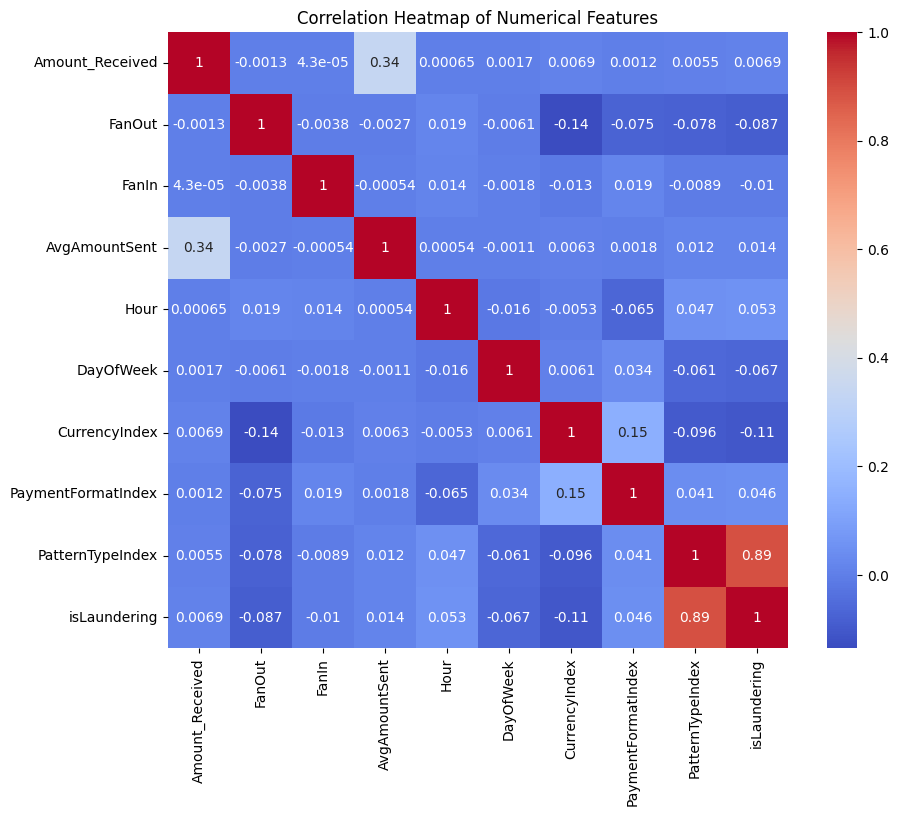

In [ ]:
# Calculate correlation matrix
correlation_matrix = Correlation.corr(df_vector, "corr_features").head()[0].toArray()

# Convert to a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, xticklabels=correlation_features, yticklabels=correlation_features, cmap="coolwarm")
plt.title("Correlation Heatmap of Numerical Features")
plt.show()


###Observations:

######-Correlation Heatmap:

Amount_Received and AvgAmountSent show a moderately positive correlation (0.34). Including both might introduce some redundancy, but they may still capture distinct aspects of the data.

Other features have relatively low correlations with each other, which generally indicates that they might add unique information to the model.

- PatternTypeIndex Has the strongest positive correlation with isLaundering (0.89).
- CurrencyIndex Shows a weak positive correlation (0.046) with isLaundering.
- PaymentFormatIndex Also shows a weak positive correlation (0.053) with isLaundering.
- FanOut and DayOfWeek Show negative correlations (-0.087 and -0.067, respectively) with isLaundering.
- Hour and AvgAmountSent Show weak positive correlations (0.014 and 0.053, respectively) with isLaundering.
- Amount_Received Has an extremely weak positive correlation (0.0059) with isLaundering, suggesting it's nearly uncorrelated.
- FanIn Has a weak negative correlation (-0.01) with isLaundering.

### Key Takeaways:
- PatternTypeIndex is the standout feature, showing a strong correlation with isLaundering. It’s critical to include this in the model.
- Features like CurrencyIndex and PaymentFormatIndex have weak correlations but could still contribute useful information when combined with others.
- Features like Amount_Received, FanIn, and Hour have very weak correlations, and their inclusion should be carefully considered to avoid adding noise to the model.


# Feature Selection

In [ ]:
# Define all features for the final assembler, using scaled and unscaled features
all_features = [ "FanOut", "AvgAmountSent", "DayOfWeek", "CurrencyIndex", "PaymentFormatIndex", "PatternTypeIndex"]

# Assemble the final feature vector for prediction
assembler_final = VectorAssembler(inputCols=all_features, outputCol="features")
balanced_featured_df = balanced_featured_df.select(all_features + ["isLaundering"])

In [ ]:
size_in_memory_gb = balanced_featured_df.rdd.map(lambda row: len(str(row))).sum() / (1024 * 1024 * 1024)
print(f"Approximate size in memory: ({size_in_memory_gb:.2f} GB)")

Approximate size in memory: (5.08 GB)


#####Split the Data:

Split the data into training, validation, and test sets.

In [ ]:
train_df, val_df, test_df = balanced_featured_df.randomSplit([0.6, 0.2, 0.2], seed=42)
balanced_featured_df.unpersist()
train_df.cache()
val_df.cache()
test_df.cache()

DataFrame[FanOut: double, AvgAmountSent: double, DayOfWeek: double, CurrencyIndex: double, PaymentFormatIndex: double, PatternTypeIndex: double, isLaundering: int]

##Model Training with Pipeline

#####Created a Pipeline with Random Forest Classifier ML model:

Defined a pipeline to streamline the feature transformations and model training process.

In [ ]:


rf = RandomForestClassifier(featuresCol="features", labelCol="isLaundering", numTrees=20, maxDepth=10)
pipeline = Pipeline(stages=[ assembler_final, rf])

#####Hyperparameter Tuning using CrossValidator:

-Used CrossValidator to find the best hyperparameters for the Random Forest model.

-BinaryClassificationEvaluator Used to evaluate the model's performance.

-areaUnderROC is a common metric for binary classification, especially useful for imbalanced datasets.

In [ ]:


paramGridSearch = ParamGridBuilder().addGrid(rf.numTrees, [10, 20]).addGrid(rf.maxDepth, [10]).build()
evaluatorr = BinaryClassificationEvaluator(labelCol="isLaundering", metricName="areaUnderROC")
crossvalidation = CrossValidator(estimator=pipeline, estimatorParamMaps=paramGridSearch, evaluator=evaluatorr, numFolds=3)
cvModel = crossvalidation.fit(train_df)


##Evaluate the Model

#####Evaluate on Validation Data:

Used F1 Score, Area Under ROC metrics to evaluate the model on validation data.

In [ ]:
# Evaluate ROC on validation data
predictions = cvModel.transform(val_df)
roc_score = evaluatorr.evaluate(predictions)
print("Area Under ROC Score on validation data:", roc_score)


Area Under ROC Score on validation data: 1.0


In [ ]:

# Evaluate F1 Score on validation data
evaluator_f1 = MulticlassClassificationEvaluator(labelCol="isLaundering", predictionCol="prediction", metricName="f1")
f1_score = evaluator_f1.evaluate(predictions)
print("F1 Score on validation data:", f1_score)


F1 Score on validation data: 1.0


#####Final Testing:

Test the model on the test set to get final performance metrics.

In [ ]:
# Evaluate ROC on test data
final_predictions = cvModel.transform(test_df)
test_roc_score = evaluatorr.evaluate(final_predictions)
print("Final ROC Score on test data:", test_roc_score)

Final ROC Score on test data: 1.0


In [ ]:
# Evaluate F1 Score on test data
test_f1_score = evaluator_f1.evaluate(final_predictions)
print("Final F1 Score on test data:", test_f1_score)

Final F1 Score on test data: 1.0


In [ ]:
#evaluate percision and recall
precision_evaluator = MulticlassClassificationEvaluator(
    labelCol="isLaundering", predictionCol="prediction", metricName="weightedPrecision")
recall_evaluator = MulticlassClassificationEvaluator(
    labelCol="isLaundering", predictionCol="prediction", metricName="weightedRecall")

precision = precision_evaluator.evaluate(final_predictions)
recall = recall_evaluator.evaluate(final_predictions)

print(f"Precision: {precision}")
print(f"Recall: {recall}")


## Observations

Unrealistically Good Performance, can be caused by

### - Data Leakage: 

If features or information from the test data inadvertently influenced the training process, the model could appear to perform perfectly.
Like Using features directly derived from the target variable. **(PatternTypeIndex)**


### Trying again without **PatternTypeIndex**

In [ ]:
# Define all features for the final assembler, using scaled and unscaled features
all_features = [ "FanOut", "AvgAmountSent", "DayOfWeek", "CurrencyIndex", "PaymentFormatIndex"]

# Assemble the final feature vector for prediction
assembler_final = VectorAssembler(inputCols=all_features, outputCol="features")
balanced_featured_df = balanced_featured_df.select(all_features + ["isLaundering"])

In [ ]:
train_df, val_df, test_df = balanced_featured_df.randomSplit([0.6, 0.2, 0.2], seed=42)

In [ ]:
rf = RandomForestClassifier(featuresCol="features", labelCol="isLaundering", numTrees=20, maxDepth=10)
pipeline = Pipeline(stages=[ assembler_final, rf])

In [ ]:
paramGridSearch = ParamGridBuilder().addGrid(rf.numTrees, [10, 20]).addGrid(rf.maxDepth, [10]).build()
evaluatorr = BinaryClassificationEvaluator(labelCol="isLaundering", metricName="areaUnderROC")
crossvalidation = CrossValidator(estimator=pipeline, estimatorParamMaps=paramGridSearch, evaluator=evaluatorr, numFolds=3)
cvModel = crossvalidation.fit(train_df)

In [ ]:
# Evaluate ROC on validation data
predictions = cvModel.transform(val_df)
roc_score = evaluatorr.evaluate(predictions)
print("Area Under ROC Score on validation data:", roc_score)


Area Under ROC Score on validation data: 0.9273795976908723


In [ ]:

# Evaluate F1 Score on validation data
evaluator_f1 = MulticlassClassificationEvaluator(labelCol="isLaundering", predictionCol="prediction", metricName="f1")
f1_score = evaluator_f1.evaluate(predictions)
print("F1 Score on validation data:", f1_score)


F1 Score on validation data: 0.9631635816315597


In [ ]:
# Evaluate ROC on test data
final_predictions = cvModel.transform(test_df)
test_roc_score = evaluatorr.evaluate(final_predictions)
print("Final ROC Score on test data:", test_roc_score)

Final ROC Score on test data: 0.9280562970683782


In [ ]:
# Evaluate F1 Score on test data
test_f1_score = evaluator_f1.evaluate(final_predictions)
print("Final F1 Score on test data:", test_f1_score)

Final F1 Score on test data: 0.9631684582954383


In [ ]:
#evaluate percision and recall
precision_evaluator = MulticlassClassificationEvaluator(
    labelCol="isLaundering", predictionCol="prediction", metricName="weightedPrecision")
recall_evaluator = MulticlassClassificationEvaluator(
    labelCol="isLaundering", predictionCol="prediction", metricName="weightedRecall")

precision = precision_evaluator.evaluate(final_predictions)
recall = recall_evaluator.evaluate(final_predictions)

print(f"Precision: {precision}")
print(f"Recall: {recall}")


Precision: 0.9656511805994707
Recall: 0.9653818345410434


## Metrics Overview

### Validation Data:

Area Under ROC (AUC): 0.927

indicates the model separates positive and negative classes well.

F1 Score: 0.963

Suggests a strong balance between precision and recall on validation data.

### Test Data:

Area Under ROC (AUC): 0.928

Similar to validation, indicating consistent performance across datasets.

F1 Score: 0.963

Strong alignment with validation F1, showing generalization capability.

Precision: 0.966

Indicates that 96.6% of the model's positive predictions are correct.

Recall: 0.965

Suggests the model identified 96.5% of actual positive instances.

### checking feature Importance

In [ ]:
rf_model = cvModel.bestModel.stages[-1]  # Access the trained Random Forest model
importances = rf_model.featureImportances.toArray()
print("Feature Importances:", importances)

Feature Importances: [0.03029107 0.06397863 0.72994748 0.03267457 0.14310825]


### Feature Importance
######The feature importances are:

DayOfWeek (1st highest): 0.729 (dominant feature)

PaymentFormatIndex (2nd highest): 0.143

AvgAmountSent: 0.063

CurrencyIndex: 0.032

FanOut (least important): 0.030

**Analysis:**
The model relies heavily on DayOfWeek and PaymentFormatIndex, contributing ~87% of the total importance.

## Analyze the predictions 
to ensure the model is not trivially predicting the majority or minority

In [ ]:
# Count predicted classes
final_predictions.groupBy("prediction").count().show()

+----------+-------+
|prediction|  count|
+----------+-------+
|       0.0|6523531|
|       1.0| 633954|
+----------+-------+



In [ ]:
# Calculate confusion matrix
final_predictions.crosstab("isLaundering", "prediction").show()

+-----------------------+-------+------+
|isLaundering_prediction|    0.0|   1.0|
+-----------------------+-------+------+
|                      0|6292500| 16748|
|                      1| 231031|617206|
+-----------------------+-------+------+



# Observations

**True Positives (TP):** 617,206 (Correctly identified laundering cases).

**True Negatives (TN):** 6,292,500 (Correctly identified non-laundering cases).

**False Positives (FP):** 16,748 (Misclassified non-laundering as laundering).

    While relatively low compared to true negatives, false positives could cause unnecessary investigations.

**False Negatives (FN):** 231,031 (Missed laundering cases). 

    which could be critical in real-world anti-money laundering applications.


In [ ]:
train_df.unpersist()
val_df.unpersist()
test_df.unpersist()